# Data Science Bootcamp - projekt finalny 

## Poniższy nootebook przedstawia analizę danych dostępnych w ramach zbioru danych "Ames Iowa: Alternative to the Boston Housing Data Set" 

OPIS

Link do danych:
<br> http://web.stanford.edu/class/stats191/data/ames2000_NAfix.csv 
<br>Dokładny opis danych: 
<br>http://web.stanford.edu/class/stats191/data/amesdoc.txt

Przydatne linki:
https://pandas.pydata.org/pandas-docs/stable/index.html

https://towardsdatascience.com/exploratory-data-analysis-eda-python-87178e35b14


# 1 - data analysis

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


In [2]:
# path to URL from Chrome DevTools Console
url = "http://web.stanford.edu/class/stats191/data/ames2000_NAfix.csv"

#importowanie danych
data_orginal = pd.read_csv(url)

#dane, które będe modyfikował zapisuje skopiowanym df 
data = data_orginal.copy()

data.head(7)

,MS.SubClass,MS.Zoning,Lot.Frontage,Lot.Area,Street,Alley,Lot.Shape,Land.Contour,Utilities,Lot.Config,...,Pool.Area,Pool.QC,Fence,Misc.Feature,Misc.Val,Mo.Sold,Yr.Sold,Sale.Type,Sale.Condition,SalePrice
0,120,RL,34,3901,Pave,None,Reg,Lvl,AllPub,Inside,...,0,None,None,None,0,8,2007,New,Partial,204000
1,20,RL,70,8400,Pave,None,Reg,Lvl,AllPub,Corner,...,0,None,MnPrv,None,0,4,2010,WD,Normal,126000
2,85,RL,60,7200,Pave,None,Reg,Lvl,AllPub,Inside,...,0,None,MnPrv,None,0,4,2009,WD,Normal,133900
3,90,RL,64,7018,Pave,None,Reg,Bnk,AllPub,Inside,...,0,None,None,None,0,6,2009,WD,Alloca,118858
4,60,RL,111,16259,Pave,None,Reg,Lvl,AllPub,Corner,...,0,None,None,None,0,9,2006,New,Partial,342643
5,20,RL,50,4280,Pave,None,IR1,Lvl,AllPub,Inside,...,0,None,None,None,0,9,2009,WD,Normal,88750
6,20,RL,155,20064,Pave,None,IR1,Low,AllPub,Inside,...,0,None,None,None,0,5,2007,WD,Normal,279000


In [3]:
data.tail(7)

,MS.SubClass,MS.Zoning,Lot.Frontage,Lot.Area,Street,Alley,Lot.Shape,Land.Contour,Utilities,Lot.Config,...,Pool.Area,Pool.QC,Fence,Misc.Feature,Misc.Val,Mo.Sold,Yr.Sold,Sale.Type,Sale.Condition,SalePrice
1993,20,RL,65,14753,Pave,None,IR2,Low,AllPub,Inside,...,0,None,GdPrv,None,0,12,2009,WD,Normal,207000
1994,20,RL,87,10367,Pave,None,IR1,Lvl,AllPub,Inside,...,0,None,None,None,0,6,2009,ConLI,Normal,335000
1995,80,RL,80,8000,Pave,None,Reg,Lvl,AllPub,Inside,...,0,None,GdWo,None,0,7,2009,WD,Normal,138000
1996,180,RM,35,3675,Pave,None,Reg,Lvl,AllPub,Inside,...,0,None,None,None,0,6,2008,WD,Normal,148000
1997,60,RL,76,10142,Pave,None,IR1,Lvl,AllPub,Inside,...,0,None,None,None,0,1,2010,WD,Normal,233000
1998,85,RL,None,7252,Pave,None,IR1,Lvl,AllPub,CulDSac,...,0,None,None,None,0,4,2009,WD,Normal,134900
1999,160,FV,34,2998,Pave,None,Reg,Lvl,AllPub,Inside,...,0,None,None,None,0,8,2009,WD,Normal,180000


In [4]:
data.shape
#2000 obserwacji dla 80 zmiennych

(2000, 80)

In [5]:
data.describe(include='all')

,MS.SubClass,MS.Zoning,Lot.Frontage,Lot.Area,Street,Alley,Lot.Shape,Land.Contour,Utilities,Lot.Config,...,Pool.Area,Pool.QC,Fence,Misc.Feature,Misc.Val,Mo.Sold,Yr.Sold,Sale.Type,Sale.Condition,SalePrice
count,2000.000000,2000,2000,2000.000000,2000,2000,2000,2000,2000,2000,...,2000.000000,2000,2000,2000,2000.00000,2000.000000,2000.000000,2000,2000,2000.000000
unique,NaN,7,121,NaN,2,3,4,4,1,5,...,NaN,5,5,5,NaN,NaN,NaN,10,6,NaN
top,NaN,RL,None,NaN,Pave,None,Reg,Lvl,AllPub,Inside,...,NaN,None,None,None,NaN,NaN,NaN,WD,Normal,NaN
freq,NaN,1549,334,NaN,1992,1865,1275,1809,2000,1452,...,NaN,1989,1605,1926,NaN,NaN,NaN,1738,1640,NaN
mean,56.945000,NaN,NaN,10296.665000,NaN,NaN,NaN,NaN,NaN,NaN,...,2.934000,NaN,NaN,NaN,42.51300,6.217500,2007.799500,NaN,NaN,180240.902000
std,42.699281,NaN,NaN,8828.208491,NaN,NaN,NaN,NaN,NaN,NaN,...,41.080828,NaN,NaN,NaN,440.83108,2.726336,1.316118,NaN,NaN,78461.927874
min,20.000000,NaN,NaN,1300.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,0.00000,1.000000,2006.000000,NaN,NaN,12789.000000
25%,20.000000,NaN,NaN,7500.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,0.00000,4.000000,2007.000000,NaN,NaN,129000.000000
50%,50.000000,NaN,NaN,9465.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,0.00000,6.000000,2008.000000,NaN,NaN,160000.000000
75%,70.000000,NaN,NaN,11500.000000,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,0.00000,8.000000,2009.000000,NaN,NaN,213492.500000


In [6]:
pd.set_option('display.max_columns', None)  
pd.set_option('display.expand_frame_repr', False)
pd.set_option('max_colwidth', -1)

data[data.SalePrice == data.SalePrice.max()]

/Users/m.owczarek/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  This is separate from the ipykernel package so we can avoid doing imports until


,MS.SubClass,MS.Zoning,Lot.Frontage,Lot.Area,Street,Alley,Lot.Shape,Land.Contour,Utilities,Lot.Config,Land.Slope,Neighborhood,Condition.1,Condition.2,Bldg.Type,House.Style,Overall.Qual,Overall.Cond,Year.Built,Year.Remod.Add,Roof.Style,Roof.Matl,Exterior.1st,Exterior.2nd,Mas.Vnr.Type,Mas.Vnr.Area,Exter.Qual,Exter.Cond,Foundation,Bsmt.Qual,Bsmt.Cond,Bsmt.Exposure,BsmtFin.Type.1,BsmtFin.SF.1,BsmtFin.Type.2,BsmtFin.SF.2,Bsmt.Unf.SF,Total.Bsmt.SF,Heating,Heating.QC,Central.Air,Electrical,X1st.Flr.SF,X2nd.Flr.SF,Low.Qual.Fin.SF,Gr.Liv.Area,Bsmt.Full.Bath,Bsmt.Half.Bath,Full.Bath,Half.Bath,Bedroom.AbvGr,Kitchen.AbvGr,Kitchen.Qual,TotRms.AbvGrd,Functional,Fireplaces,Fireplace.Qu,Garage.Type,Garage.Yr.Blt,Garage.Finish,Garage.Cars,Garage.Area,Garage.Qual,Garage.Cond,Paved.Drive,Wood.Deck.SF,Open.Porch.SF,Enclosed.Porch,X3Ssn.Porch,Screen.Porch,Pool.Area,Pool.QC,Fence,Misc.Feature,Misc.Val,Mo.Sold,Yr.Sold,Sale.Type,Sale.Condition,SalePrice
580,60,RL,104,21535,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,NoRidge,Norm,Norm,1Fam,2Story,10,6,1994,1995,Gable,WdShngl,HdBoard,HdBoard,BrkFace,1170,Ex,TA,PConc,Ex,TA,Gd,GLQ,1455,Unf,0,989,2444,GasA,Ex,Y,SBrkr,2444,1872,0,4316,0,1,3,1,4,1,Ex,10,Typ,2,Ex,Attchd,1994,Fin,3,832,TA,TA,Y,382,50,0,0,0,0,None,None,None,0,1,2007,WD,Normal,755000


In [7]:
data[data.SalePrice == data.SalePrice.min()]

,MS.SubClass,MS.Zoning,Lot.Frontage,Lot.Area,Street,Alley,Lot.Shape,Land.Contour,Utilities,Lot.Config,Land.Slope,Neighborhood,Condition.1,Condition.2,Bldg.Type,House.Style,Overall.Qual,Overall.Cond,Year.Built,Year.Remod.Add,Roof.Style,Roof.Matl,Exterior.1st,Exterior.2nd,Mas.Vnr.Type,Mas.Vnr.Area,Exter.Qual,Exter.Cond,Foundation,Bsmt.Qual,Bsmt.Cond,Bsmt.Exposure,BsmtFin.Type.1,BsmtFin.SF.1,BsmtFin.Type.2,BsmtFin.SF.2,Bsmt.Unf.SF,Total.Bsmt.SF,Heating,Heating.QC,Central.Air,Electrical,X1st.Flr.SF,X2nd.Flr.SF,Low.Qual.Fin.SF,Gr.Liv.Area,Bsmt.Full.Bath,Bsmt.Half.Bath,Full.Bath,Half.Bath,Bedroom.AbvGr,Kitchen.AbvGr,Kitchen.Qual,TotRms.AbvGrd,Functional,Fireplaces,Fireplace.Qu,Garage.Type,Garage.Yr.Blt,Garage.Finish,Garage.Cars,Garage.Area,Garage.Qual,Garage.Cond,Paved.Drive,Wood.Deck.SF,Open.Porch.SF,Enclosed.Porch,X3Ssn.Porch,Screen.Porch,Pool.Area,Pool.QC,Fence,Misc.Feature,Misc.Val,Mo.Sold,Yr.Sold,Sale.Type,Sale.Condition,SalePrice
1253,30,RM,68,9656,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,1Fam,1Story,2,2,1923,1970,Gable,CompShg,AsbShng,AsbShng,None,0,TA,Fa,BrkTil,Fa,Fa,No,Unf,0,Unf,0,678,678,GasA,TA,N,SBrkr,832,0,0,832,0,0,1,0,2,1,TA,5,Typ,1,Gd,Detchd,1928,Unf,2,780,Fa,Fa,N,0,0,0,0,0,0,None,None,None,0,6,2010,WD,Abnorml,12789


In [8]:
data.isnull().sum()

MS.SubClass       0
MS.Zoning         0
Lot.Frontage      0
Lot.Area          0
Street            0
                 ..
Mo.Sold           0
Yr.Sold           0
Sale.Type         0
Sale.Condition    0
SalePrice         0
Length: 80, dtype: int64

In [9]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    print(data.dtypes)

MS.SubClass        int64 
MS.Zoning          object
Lot.Frontage       object
Lot.Area           int64 
Street             object
Alley              object
Lot.Shape          object
Land.Contour       object
Utilities          object
Lot.Config         object
Land.Slope         object
Neighborhood       object
Condition.1        object
Condition.2        object
Bldg.Type          object
House.Style        object
Overall.Qual       int64 
Overall.Cond       int64 
Year.Built         int64 
Year.Remod.Add     int64 
Roof.Style         object
Roof.Matl          object
Exterior.1st       object
Exterior.2nd       object
Mas.Vnr.Type       object
Mas.Vnr.Area       object
Exter.Qual         object
Exter.Cond         object
Foundation         object
Bsmt.Qual          object
Bsmt.Cond          object
Bsmt.Exposure      object
BsmtFin.Type.1     object
BsmtFin.SF.1       object
BsmtFin.Type.2     object
BsmtFin.SF.2       object
Bsmt.Unf.SF        object
Total.Bsmt.SF      object
Heating     

biblioteka do komplekswej analizy danych

In [10]:

from pandas_profiling import ProfileReport

profile = ProfileReport(data, title='Pandas Profiling Report')

In [12]:
profile.to_notebook_iframe()

In [13]:
profile.to_file("Profiling_report.html")

In [11]:
corr = data.corr()

corr.style.background_gradient(cmap='coolwarm').set_precision(2)

,MS.SubClass,Lot.Area,Overall.Qual,Overall.Cond,Year.Built,Year.Remod.Add,X1st.Flr.SF,X2nd.Flr.SF,Low.Qual.Fin.SF,Gr.Liv.Area,Full.Bath,Half.Bath,Bedroom.AbvGr,Kitchen.AbvGr,TotRms.AbvGrd,Fireplaces,Wood.Deck.SF,Open.Porch.SF,Enclosed.Porch,X3Ssn.Porch,Screen.Porch,Pool.Area,Misc.Val,Mo.Sold,Yr.Sold,SalePrice
MS.SubClass,1.00,-0.17,0.03,-0.08,0.02,0.03,-0.24,0.31,0.03,0.09,0.13,0.18,-0.01,0.26,0.05,-0.04,-0.02,-0.00,-0.01,-0.02,-0.03,0.00,-0.03,-0.01,-0.00,-0.08
Lot.Area,-0.17,1.00,0.08,-0.04,0.01,0.02,0.30,0.03,-0.00,0.25,0.12,0.02,0.12,-0.02,0.19,0.25,0.16,0.07,0.02,0.02,0.04,0.08,0.03,-0.01,-0.02,0.24
Overall.Qual,0.03,0.08,1.00,-0.11,0.60,0.57,0.48,0.26,-0.04,0.58,0.53,0.26,0.07,-0.18,0.38,0.40,0.25,0.31,-0.14,0.01,0.04,0.05,-0.01,0.03,-0.01,0.80
Overall.Cond,-0.08,-0.04,-0.11,1.00,-0.37,0.07,-0.18,0.00,0.00,-0.14,-0.22,-0.09,-0.02,-0.09,-0.10,-0.05,0.02,-0.08,0.08,0.05,0.04,-0.02,0.08,-0.00,0.04,-0.12
Year.Built,0.02,0.01,0.60,-0.37,1.00,0.61,0.32,0.03,-0.13,0.26,0.48,0.27,-0.04,-0.13,0.13,0.18,0.23,0.20,-0.36,0.02,-0.04,0.01,-0.03,0.01,0.01,0.57
Year.Remod.Add,0.03,0.02,0.57,0.07,0.61,1.00,0.24,0.16,-0.05,0.31,0.45,0.21,-0.02,-0.14,0.21,0.13,0.21,0.24,-0.22,0.06,-0.05,-0.00,0.01,-0.00,0.04,0.53
X1st.Flr.SF,-0.24,0.30,0.48,-0.18,0.32,0.24,1.00,-0.25,-0.01,0.55,0.38,-0.11,0.13,0.10,0.37,0.41,0.22,0.20,-0.07,0.04,0.08,0.14,-0.02,0.05,-0.03,0.62
X2nd.Flr.SF,0.31,0.03,0.26,0.00,0.03,0.16,-0.25,1.00,0.01,0.67,0.40,0.60,0.49,0.04,0.60,0.17,0.09,0.22,0.05,-0.01,0.02,0.06,-0.00,-0.01,-0.00,0.30
Low.Qual.Fin.SF,0.03,-0.00,-0.04,0.00,-0.13,-0.05,-0.01,0.01,1.00,0.08,0.00,-0.04,0.08,0.01,0.10,-0.02,-0.01,-0.02,0.04,0.00,-0.02,0.05,-0.00,0.01,-0.01,-0.05
Gr.Liv.Area,0.09,0.25,0.58,-0.14,0.26,0.31,0.55,0.67,0.08,1.00,0.63,0.43,0.52,0.11,0.80,0.46,0.24,0.33,-0.01,0.02,0.07,0.16,-0.01,0.03,-0.02,0.72


## 1.1 Wnioski

UWAGA: jeżeli w nottebooku nie wyświelta się Profiling report w repozytorium znajduje się wersja w pliku .html

* 
*
*
*


# 2 - Modelowanie

## 2.1 Podział na train i test

In [13]:
train_data = data.copy().drop('SalePrice', axis = 1)
y_train = data.SalePrice.copy()

In [14]:
from sklearn.model_selection import train_test_split
train_data, X_test, y_train, y_test = train_test_split(train_data, y_train, test_size=0.33, random_state=42)

In [15]:
print(X_test.shape)

(660, 79)


In [16]:
print(train_data.shape)

(1340, 79)


In [17]:
print(y_test.shape)

(660,)


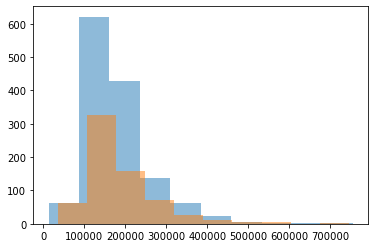

In [18]:


plt.hist(y_train, alpha=0.5)
plt.hist(y_test, alpha=0.5)
plt.show()

In [19]:
train_data.head()

,MS.SubClass,MS.Zoning,Lot.Frontage,Lot.Area,Street,Alley,Lot.Shape,Land.Contour,Utilities,Lot.Config,Land.Slope,Neighborhood,Condition.1,Condition.2,Bldg.Type,House.Style,Overall.Qual,Overall.Cond,Year.Built,Year.Remod.Add,Roof.Style,Roof.Matl,Exterior.1st,Exterior.2nd,Mas.Vnr.Type,Mas.Vnr.Area,Exter.Qual,Exter.Cond,Foundation,Bsmt.Qual,Bsmt.Cond,Bsmt.Exposure,BsmtFin.Type.1,BsmtFin.SF.1,BsmtFin.Type.2,BsmtFin.SF.2,Bsmt.Unf.SF,Total.Bsmt.SF,Heating,Heating.QC,Central.Air,Electrical,X1st.Flr.SF,X2nd.Flr.SF,Low.Qual.Fin.SF,Gr.Liv.Area,Bsmt.Full.Bath,Bsmt.Half.Bath,Full.Bath,Half.Bath,Bedroom.AbvGr,Kitchen.AbvGr,Kitchen.Qual,TotRms.AbvGrd,Functional,Fireplaces,Fireplace.Qu,Garage.Type,Garage.Yr.Blt,Garage.Finish,Garage.Cars,Garage.Area,Garage.Qual,Garage.Cond,Paved.Drive,Wood.Deck.SF,Open.Porch.SF,Enclosed.Porch,X3Ssn.Porch,Screen.Porch,Pool.Area,Pool.QC,Fence,Misc.Feature,Misc.Val,Mo.Sold,Yr.Sold,Sale.Type,Sale.Condition
81,30,RM,60,6180,Pave,None,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Norm,Norm,1Fam,1Story,6,5,1926,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,960,960,GasA,TA,N,SBrkr,986,0,0,986,0,0,1,0,2,1,TA,5,Typ,1,Gd,Detchd,1926,Unf,1,180,TA,TA,Y,0,128,0,0,0,0,None,None,None,0,5,2007,WD,Normal
915,20,RL,None,11500,Pave,None,IR1,Lvl,AllPub,CulDSac,Gtl,Edwards,Norm,Norm,1Fam,1Story,4,3,1957,1957,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,Gd,Slab,None,None,None,None,0,None,0,0,0,GasA,Ex,N,SBrkr,845,0,0,845,0,0,1,0,3,1,TA,5,Typ,0,None,Detchd,1957,Unf,1,290,TA,TA,N,186,0,0,0,0,0,None,None,None,0,1,2009,WD,Normal
1018,45,RM,50,5000,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,RRAe,Norm,1Fam,1.5Unf,5,6,1941,1950,Gable,CompShg,MetalSd,MetalSd,None,0,TA,TA,CBlock,TA,TA,Av,BLQ,116,Unf,0,604,720,GasA,Po,N,FuseF,803,0,0,803,0,0,1,0,2,1,TA,5,Typ,0,None,Detchd,1941,Unf,2,360,TA,TA,Y,0,0,244,0,0,0,None,None,None,0,12,2007,WD,Normal
380,20,RL,None,9500,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,Nonemes,Norm,Norm,1Fam,1Story,6,5,1963,1963,Gable,CompShg,Plywood,Plywood,BrkFace,247,TA,TA,CBlock,Gd,TA,No,BLQ,609,Unf,0,785,1394,GasA,Gd,Y,SBrkr,1394,0,0,1394,1,0,1,1,3,1,TA,6,Typ,2,Gd,Attchd,1963,RFn,2,514,TA,TA,Y,0,76,0,0,185,0,None,None,None,0,7,2009,WD,Normal
1029,50,RL,60,11100,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1.5Fin,5,6,1951,1994,Gable,CompShg,Wd Sdng,Wd Sdng,None,0,TA,TA,PConc,TA,TA,Mn,LwQ,1080,Unf,0,0,1080,GasA,TA,N,SBrkr,1080,400,0,1480,1,0,1,0,4,1,TA,7,Typ,1,Gd,Attchd,1951,Unf,1,253,TA,TA,Y,0,0,68,0,0,0,None,None,None,0,7,2007,WD,Normal


## 2.2 Budowa Pipeline preprocessingu


Wykorzystamy DataframeSelector aby wybrać określone atrybuty z DataFrame:

In [20]:
from sklearn.base import BaseEstimator, TransformerMixin

# A class to select numerical or categorical columns 
# since Scikit-Learn doesn't handle DataFrames yet
class DataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, attribute_names):
        self.attribute_names = attribute_names
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        return X[self.attribute_names]

### 2.2.1 Budowa Pipeline dla atrybutow numerycnych
Zbudujmy pipeline dla atrybutów numerycznych:

In [21]:
#Jakie kolumnty są numeryczne 
data_num = data.select_dtypes('number')
print(pd.DataFrame(data_num.columns))

                  0
0   MS.SubClass    
1   Lot.Area       
2   Overall.Qual   
3   Overall.Cond   
4   Year.Built     
5   Year.Remod.Add 
6   X1st.Flr.SF    
7   X2nd.Flr.SF    
8   Low.Qual.Fin.SF
9   Gr.Liv.Area    
10  Full.Bath      
11  Half.Bath      
12  Bedroom.AbvGr  
13  Kitchen.AbvGr  
14  TotRms.AbvGrd  
15  Fireplaces     
16  Wood.Deck.SF   
17  Open.Porch.SF  
18  Enclosed.Porch 
19  X3Ssn.Porch    
20  Screen.Porch   
21  Pool.Area      
22  Misc.Val       
23  Mo.Sold        
24  Yr.Sold        
25  SalePrice      


In [22]:
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="median")

num_pipeline = Pipeline([
        ("select_numeric", DataFrameSelector(["Overall.Qual", "Year.Built", "Year.Remod.Add", "X1st.Flr.SF", "Gr.Liv.Area", "Full.Bath"])),
        ("imputer", SimpleImputer(strategy="median")),
    ])

In [23]:
num_pipeline.fit_transform(train_data)

array([[6.000e+00, 1.926e+03, 1.950e+03, 9.860e+02, 9.860e+02, 1.000e+00],
       [4.000e+00, 1.957e+03, 1.957e+03, 8.450e+02, 8.450e+02, 1.000e+00],
       [5.000e+00, 1.941e+03, 1.950e+03, 8.030e+02, 8.030e+02, 1.000e+00],
       ...,
       [6.000e+00, 1.997e+03, 1.997e+03, 1.494e+03, 1.494e+03, 2.000e+00],
       [8.000e+00, 1.978e+03, 1.978e+03, 1.226e+03, 1.226e+03, 1.000e+00],
       [8.000e+00, 2.005e+03, 2.006e+03, 2.028e+03, 2.028e+03, 2.000e+00]])

Będziemy także potrzebować imputera do kategorycznych kolumn napisowych (zwykły Imputer nie działa na tych kolumnach):

In [24]:
# Inspired from stackoverflow.com/questions/25239958
class MostFrequentImputer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        self.most_frequent_ = pd.Series([X[c].value_counts().index[0] for c in X],
                                        index=X.columns)
        return self
    def transform(self, X, y=None):
        return X.fillna(self.most_frequent_)

### 2.2.2 Budowa Pipeline dla atrybutow kategorycznych
Teraz możemy zbudować pipeline dla atrybutów kategorycznych:

In [25]:
from sklearn.preprocessing import OneHotEncoder

cat_pipeline = Pipeline([
        ("select_cat", DataFrameSelector(["MS.Zoning", "Alley"])),
        ("imputer", MostFrequentImputer()),
        ("cat_encoder", OneHotEncoder(sparse=False)),
    ])

In [26]:
cat_pipeline.fit_transform(train_data)

array([[0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.]])

In [29]:
from sklearn.pipeline import FeatureUnion
preprocess_pipeline = FeatureUnion(transformer_list=[
        ("num_pipeline", num_pipeline),
        ("cat_pipeline", cat_pipeline),
    ])

In [30]:
from sklearn.model_selection import StratifiedKFold

seed=123
kfold = StratifiedKFold(n_splits=5, random_state=seed)

## 2.3 Regresja Lioniowa
Regresja Liniowa

In [31]:
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

from sklearn.linear_model import LogisticRegression

pipe_1 = Pipeline([('preprocessing', preprocess_pipeline), ('classifier', LogisticRegression(C=1, max_iter=1000))])

param_grid_1 = {
            'classifier__C': [0.001, 0.01, 0.1, 1, 10, 100]
}

grid_1 = GridSearchCV(pipe_1, param_grid_1, cv=kfold, return_train_score=True)

grid_1.fit(train_data, y_train)
grid_1.best_params_

/Users/m.owczarek/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)
/Users/m.owczarek/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


ValueError: Found unknown categories ['I (all)'] in column 0 during transform

## 2.4 Liniowy SVM

In [32]:
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.svm import LinearSVC

pipe = Pipeline([('preprocessing', preprocess_pipeline), ('classifier', LinearSVC(C=1))])

param_grid_2 = {
            'classifier__C': [0.001, 0.01, 0.1, 1, 10, 100]
}

grid_2 = GridSearchCV(pipe, param_grid_2, cv=kfold, return_train_score=True)

grid_2.fit(train_data, y_train)
grid_2.best_params_

/Users/m.owczarek/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)
/Users/m.owczarek/anaconda3/lib/python3.7/site-packages/sklearn/svm/_base.py:977: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


ValueError: Found unknown categories ['I (all)'] in column 0 during transform

## 2.5 Random Forest

## 2.6 Metryki dla wybranych modeli

In [33]:
from sklearn import  metrics


models = []
models.append(('LR', grid_1.best_estimator_))
#models.append(('SVM linear', grid_2.best_estimator_))
#models.append(('RF', grid_3.best_estimator_))


precision_score = []
recall_score = []
f1_score = []
accuracy_score = []
for name, model in models:
    print(name)
    print("precision_score: {}".format(metrics.precision_score(y_test , model.predict(X_test), average='micro') ))
    print("recall_score: {}".format( metrics.recall_score(y_test , model.predict(X_test), average='micro') ))
    print("f1_score: {}".format( metrics.f1_score(y_test , model.predict(X_test), average='micro') ))
    print("accuracy_score: {}".format( metrics.accuracy_score(y_test , model.predict(X_test), average='micro') ))
    precision_score.append(metrics.precision_score(y_test , model.predict(X_test)))
    recall_score.append(metrics.recall_score(y_test , model.predict(X_test)))
    f1_score.append( metrics.f1_score(y_test , model.predict(X_test)))
    accuracy_score.append(metrics.accuracy_score(y_test , model.predict(X_test)))

AttributeError: 'GridSearchCV' object has no attribute 'best_estimator_'

In [34]:
import pandas as pd
d = {'precision_score': precision_score, 
     'recall_score': recall_score, 
     'f1_score': f1_score,
     'accuracy_score' : accuracy_score
    }
df = pd.DataFrame(data=d)
df.insert(loc=0, column='Method', value=['LR','SVM linear', 'RF'])
df

NameError: name 'precision_score' is not defined